## MSCRED (Multi Scale Convolutional Recurrent Encoder Decoder)

Ce script vise  a tester toutes les briques qui compose le pipeline MSCRED sur des données fictives pour ensuite créer le module qui sera utile dans notre projet de détection d'anomalie dans les flux de diagnostiques magnétique de tokamak !

### 1. Création des jeux de données et visualisation

1. Créer des signaux multivariés aléatoires et les visualiser. (ils constitueront le jeu d'entrainement)
2. Reprendre ce jeu synthétique et pour un sous-groupe, y ajouter des valeurs abérantes pour qu'ils soient les anomalies à détecter. Labeliser le tout (constituera le jeu de test).

In [20]:
import numpy as np
import matplotlib.pyplot as plt

In [21]:
def generate_multivariate_ts_1(n_variables, n_timesteps, noise_level=0.1, seed=None):
    """
    Generates realistic multivariate time series with temporal continuity and noise.
    
    Args:
        n_variables (int): Number of time series (variables)
        n_timesteps (int): Length of time series
        noise_level (float): Gaussian noise level (standard deviation)
        seed (int): Seed for reproducibility
        
    Returns:
        np.array: Matrix of time series of shape (n_variables, n_timesteps)
    """

    if seed is not None:
        np.random.seed(seed)
    
    # Matrice initialization
    data = np.zeros((n_variables, n_timesteps))
    
    # Unique parameters for each variable
    means = np.random.uniform(-10, 10, n_variables)             # Means
    volatilities = np.random.uniform(0.1, 1.0, n_variables)     # Volatilities
    trends = np.random.uniform(-0.05, 0.05, n_variables)        # Trends
    frequencies = np.random.uniform(0.01, 0.2, n_variables)     # frequencies
    
    for i in range(n_variables):
        # Random generation of the base time series (AR(1) process)
        base = np.zeros(n_timesteps)
        base[0] = np.random.normal(means[i], volatilities[i])
        
        # Adding temporal continuity
        for t in range(1, n_timesteps):
            # Autoregressive component with trend and seasonality
            drift = trends[i] * t
            season = 0.5 * np.sin(2 * np.pi * frequencies[i] * t)
            innovation = np.random.normal(0, volatilities[i])
            
            base[t] = (0.8 * base[t-1] + 0.2 * base[0] + 
                       drift + season + innovation)
        
        data[i] = base
    
    # Adding Gaussian noise
    noise = np.random.normal(0, noise_level, (n_variables, n_timesteps))
    return data + noise

In [22]:
def generate_multivariate_ts_2(n_variables: int, n_timesteps: int, noise_level: float = 0.1, seed:bool = None) -> np.ndarray:
    """
    Improved version with amplitude control and large-scale sinusoids.
    
    Args:
        n_variables (int): Number of time series
        n_timesteps (int): Length of series
        noise_level (float): Noise level (standard deviation)
        seed (int): Seed for reproducibility
        
    Returns:
        np.array: Matrix of shape (n_variables, n_timesteps)
    """
    if seed is not None:
        np.random.seed(seed)
    
    data = np.zeros((n_variables, n_timesteps))
    time = np.arange(n_timesteps)
    
    #Unique parameters for each variable
    base_amps = np.random.uniform(5, 20, n_variables)  # Amplitude de base
    slow_freqs = np.random.uniform(0.001, 0.01, n_variables)  # Fréquences lentes
    fast_freqs = np.random.uniform(0.05, 0.2, n_variables)  # Fréquences rapides
    phases = np.random.uniform(0, 2*np.pi, n_variables)  # Déphasages
    
    for i in range(n_variables):
        # Primary component (slow sinusoid)
        slow_wave = base_amps[i] * np.sin(2 * np.pi * slow_freqs[i] * time + phases[i])
        
        # Secondary component (fast sinusoid)
        fast_wave = 0.5 * base_amps[i] * np.sin(2 * np.pi * fast_freqs[i] * time)
        
        # Autoregressive noise component
        # AR(1) process with a random walk component
        ar_noise = np.zeros(n_timesteps)
        ar_noise[0] = np.random.normal(0, 1)
        for t in range(1, n_timesteps):
            ar_noise[t] = 0.7 * ar_noise[t-1] + np.random.normal(0, 0.5)
        
        # Combining components
        data[i] = slow_wave + fast_wave + ar_noise
    
    # Mesurement noise
    noise = np.random.normal(0, noise_level, (n_variables, n_timesteps))
    data = data + noise
    return (data - np.mean(data, axis=1, keepdims=True)) / np.std(data, axis=1, keepdims=True)

In [23]:
def generate_multivariate_ts_3(
    n_variables: int,
    n_timesteps: int,
    noise_level: float = 0.3,
    min_delay: int = 50,
    max_delay: int = 100,
    min_freq: int = 40,
    max_freq: int = 50,
    seed: int = None
) -> np.ndarray:
    """
    Generates synthetic multivariate time series with trigonometric patterns and noise.
    Implementation like in the MSCRED paper.

    Args:
        n_variables: Number of time series (variables/sensors)
        n_timesteps: Length of time series
        noise_level: Gaussian noise level
        min_delay: Minimum time delay (t0)
        max_delay: Maximum time delay (t0)
        min_freq: Minimum angular frequency (ω)
        max_freq: Maximum angular frequency (ω)
        seed: Seed for reproducibility

    Returns:
        A numpy array of shape (n_variables, n_timesteps)
    """
    if seed is not None:
        np.random.seed(seed)
    
    # Generate random parameters for each variable
    s_rand = np.random.randint(0, 2, size=n_variables)  # 0=sin, 1=cos
    t0 = np.random.randint(min_delay, max_delay + 1, size=n_variables)
    omega = np.random.randint(min_freq, max_freq + 1, size=n_variables)
    
    # Initialize the time series data matrix
    ts_data = np.zeros((n_variables, n_timesteps))
    time_index = np.arange(n_timesteps)
    
    for i in range(n_variables):
        base = (time_index - t0[i]) / omega[i]
        if s_rand[i] == 0:
            trig_component = np.sin(base)
        else:
            trig_component = np.cos(base)
        
        # Add gaussian noise
        noise = noise_level * np.random.randn(n_timesteps)
        ts_data[i] = trig_component + noise
    
    return ts_data

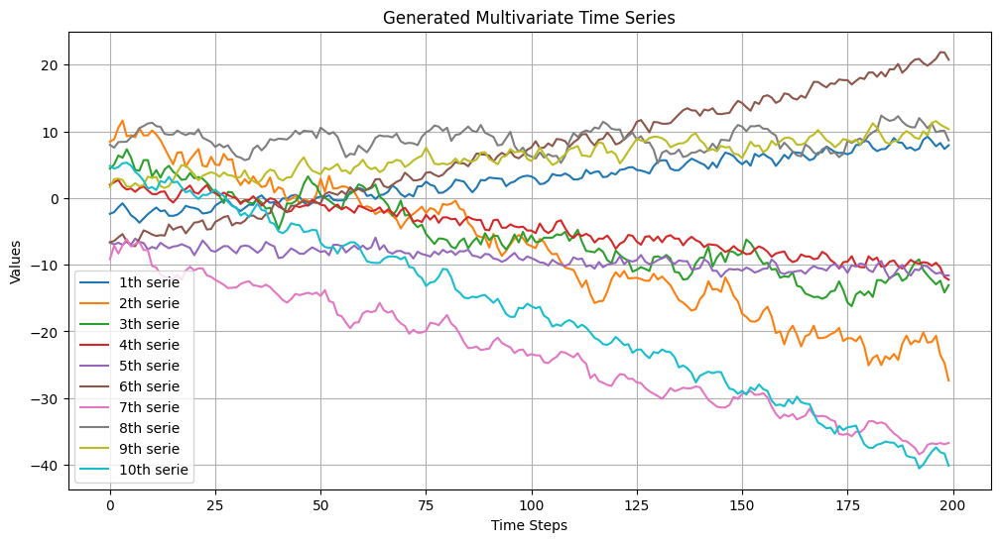

In [28]:
data_train = generate_multivariate_ts_1(
    n_variables=10,
    n_timesteps=200,
    noise_level=0.3,
    seed=42
)

plt.figure(figsize=(12, 6))
for i in range(data_train.shape[0]):
    plt.plot(data_train[i], label=f'{i+1}th serie')
plt.title('Generated Multivariate Time Series')
plt.xlabel('Time Steps')
plt.ylabel('Values')
plt.legend()
plt.grid(True)
plt.show()

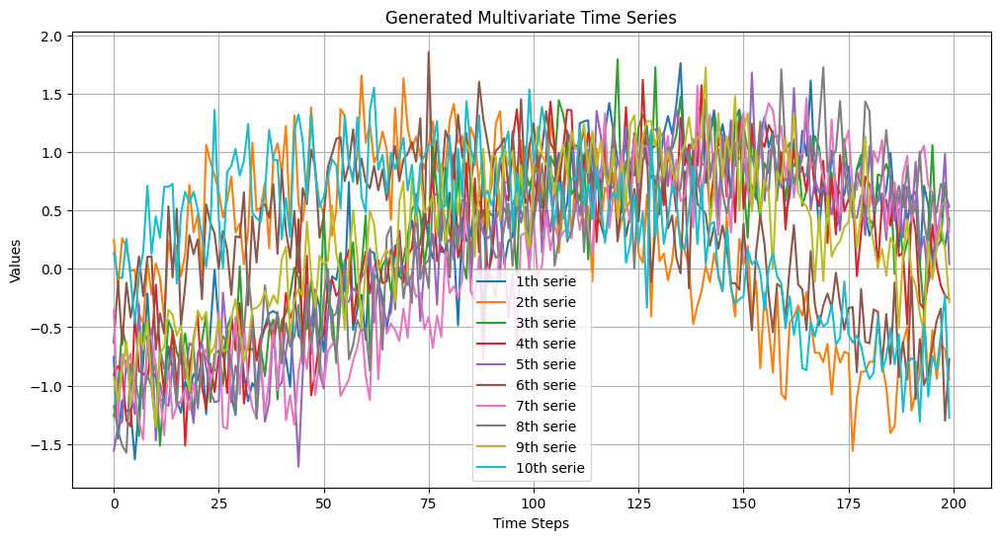

In [29]:
data_train = generate_multivariate_ts_3(
    n_variables=10,
    n_timesteps=200,
    noise_level=0.3,
    seed=42
)

plt.figure(figsize=(12, 6))
for i in range(data_train.shape[0]):
    plt.plot(data_train[i], label=f'{i+1}th serie')
plt.title('Generated Multivariate Time Series')
plt.xlabel('Time Steps')
plt.ylabel('Values')
plt.legend()
plt.grid(True)
plt.show()

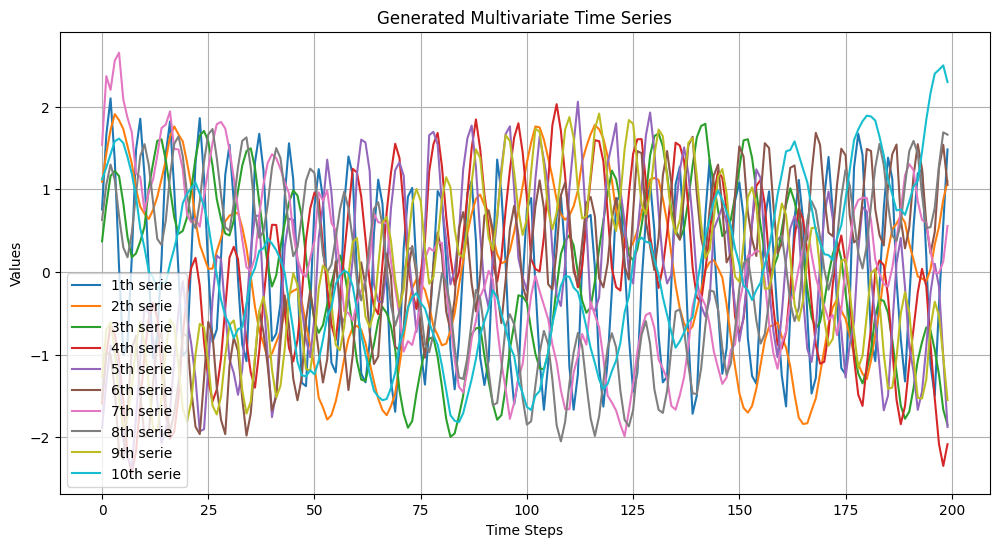

In [30]:
data_train = generate_multivariate_ts_2(
    n_variables=10,
    n_timesteps=200,
    noise_level=0.3,
    seed=42
)

plt.figure(figsize=(12, 6))
for i in range(data_train.shape[0]):
    plt.plot(data_train[i], label=f'{i+1}th serie')
plt.title('Generated Multivariate Time Series')
plt.xlabel('Time Steps')
plt.ylabel('Values')
plt.legend()
plt.grid(True)
plt.show()

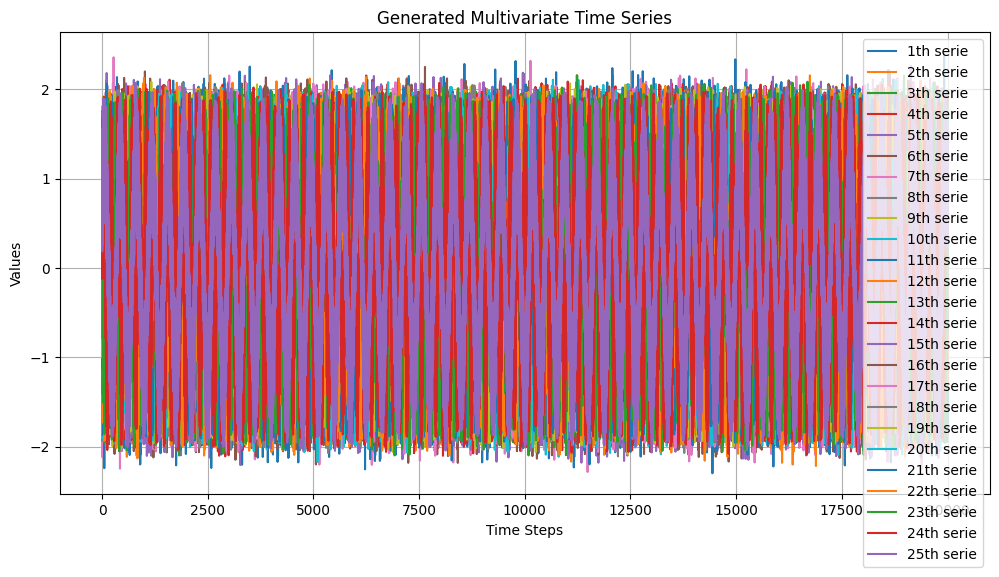

In [31]:
data_train = generate_multivariate_ts_2(
    n_variables=25,
    n_timesteps=20000,
    noise_level=0.3,
    seed=42
)

plt.figure(figsize=(12, 6))
for i in range(data_train.shape[0]):
    plt.plot(data_train[i], label=f'{i+1}th serie')
plt.title('Generated Multivariate Time Series')
plt.xlabel('Time Steps')
plt.ylabel('Values')
plt.legend()
plt.grid(True)
plt.show()

### 2. Generate "correlation" matrixes from thosee times series.

In [32]:
def generate_signature_matrix(
    data: np.ndarray,
    win_size: list[int] = [10, 30, 60],
    min_time: int = 0,
    max_time: int = None,
    gap_time: int = 10,
    normalize: bool = True,
    save_path: str = None
) -> np.ndarray:
    """
    Generates multi-scale signature matrices from multivariate time series.
    
    Args:
        data: Input data in the form (n_sensors, n_timesteps)
        win_size: List of window sizes
        min_time: Starting time point
        max_time: Ending time point (if None, uses total length)
        gap_time: Interval between segments
        normalize: If True, applies min-max normalization
        save_path: Path to save matrices (if None, no save)
    
    Returns:
        4D array of signature matrices with shape [time, len(win_sizes), n_sensors, n_sensors]
    """
    if max_time is None:
        max_time = data.shape[1]

    sensor_n = data.shape[0]
    time_steps = (max_time - min_time) // gap_time
    n_win = len(win_size)
    
    # Min-Max normalization
    if normalize:
        min_val = np.min(data, axis=1, keepdims=True)
        max_val = np.max(data, axis=1, keepdims=True)
        data = (data - min_val) / (max_val - min_val + 1e-6)
    
    # Initialize 4D array [time, n, n, 3]
    result = np.zeros((time_steps, n_win, sensor_n, sensor_n))
    
    for w_idx, win in enumerate(win_size):
        print(f"Generating signature matrices with window {win}...")
        
        for t_idx, t in enumerate(range(min_time, max_time, gap_time)):
            if t < win:  # Not enough data for the window
                mat = np.zeros((sensor_n, sensor_n))
            else:
                segment = data[:, t-win:t]
                mat = np.zeros((sensor_n, sensor_n))
                
                for i in range(sensor_n):
                    for j in range(i, sensor_n):
                        mat[i,j] = np.inner(segment[i], segment[j]) / win
                        mat[j,i] = mat[i,j]  # Symmetry
                        
            result[t_idx, w_idx, :, :] = mat
        
        if save_path:
            np.save(f"{save_path}/matrix_win_{win}.npy", result[:,w_idx,:,:])
    
    print("Signature matrix generation completed!")
    return result

In [33]:
win_size = [10, 30, 60]
min_time = 0
max_time = None
gap_time = 10
normalize = True

signature_matrices = generate_signature_matrix(
        data=data_train,
        win_size=win_size,
        min_time=min_time,
        max_time=max_time,
        gap_time=gap_time,
        normalize=normalize,
        save_path=None
    )

Generating signature matrices with window 10...
Generating signature matrices with window 30...
Generating signature matrices with window 60...
Signature matrix generation completed!


In [34]:
from matplotlib.gridspec import GridSpec

def plot_signature_matrices(
    matrix_4d: np.ndarray,
    win_sizes: list[int] = [10, 30, 60], 
    gap_time: int = 10, 
    sample_times: list[int] = [30, 100, 200],
    figsize: tuple = (12, 8)
) -> None:
    """
    Visualizes multi-scale signature matrices from 4D array [time, len(win_sizes), n, n].
    
    Args:
        matrix_4d: 4D array of signature matrices with shape [time, len(win_sizes), n, n]
        win_sizes: List of window sizes corresponding to the win channels
        gap_time: Time step between segments
        sample_times: Times to visualize (e.g., [start, middle, end] = [max(win_sizes), len(time)/2, len(time)])
        figsize: Figure dimensions

    Returns:
        None: Displays the signature matrices
    """
    # Entries validation
    if matrix_4d.ndim != 4:
        raise ValueError("Input matrix must be 4D array [time, len(win_sizes), n, n]")
    
    n_win = len(win_sizes)
    n_samples = len(sample_times)
    
    # Create grid with correct dimensions
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(n_win, n_samples + 1, 
                 width_ratios=[1]*n_samples + [0.05],
                 height_ratios=[1]*n_win)

    # Find global min/max for consistent color scaling
    vmin, vmax = np.percentile(matrix_4d, [5, 95])

    # Plot signature matrices
    for i, win_size in enumerate(win_sizes):
        for j, t in enumerate(sample_times):
            ax = plt.subplot(gs[i, j])
            
            # Calculate matrix index
            matrix_idx = t // gap_time
            if matrix_idx >= matrix_4d.shape[0]:
                matrix_idx = -1  # Use last available matrix
                
            # Get the matrix for this window size and time
            mat = matrix_4d[matrix_idx, i, :, :]
            
            # Plot matrix
            im = ax.imshow(mat, cmap='coolwarm', vmin=vmin, vmax=vmax)
            ax.set_title(f"t = {t}\nw = {win_size}", fontsize=10)
            ax.set_xticks([])
            ax.set_yticks([])
            
            # Add sensor labels on last row and first column
            if i == n_win - 1:
                ax.set_xlabel(f"Sensor {j+1}", fontsize=9)
            if j == 0:
                ax.set_ylabel(f"Scale {i+1}", fontsize=9)

    # Add colorbar
    cax = plt.subplot(gs[:, -1])
    plt.colorbar(im, cax=cax, label="Correlation")
    
    plt.suptitle("Multi-scale Signature Matrices", fontsize=14, y=0.98)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

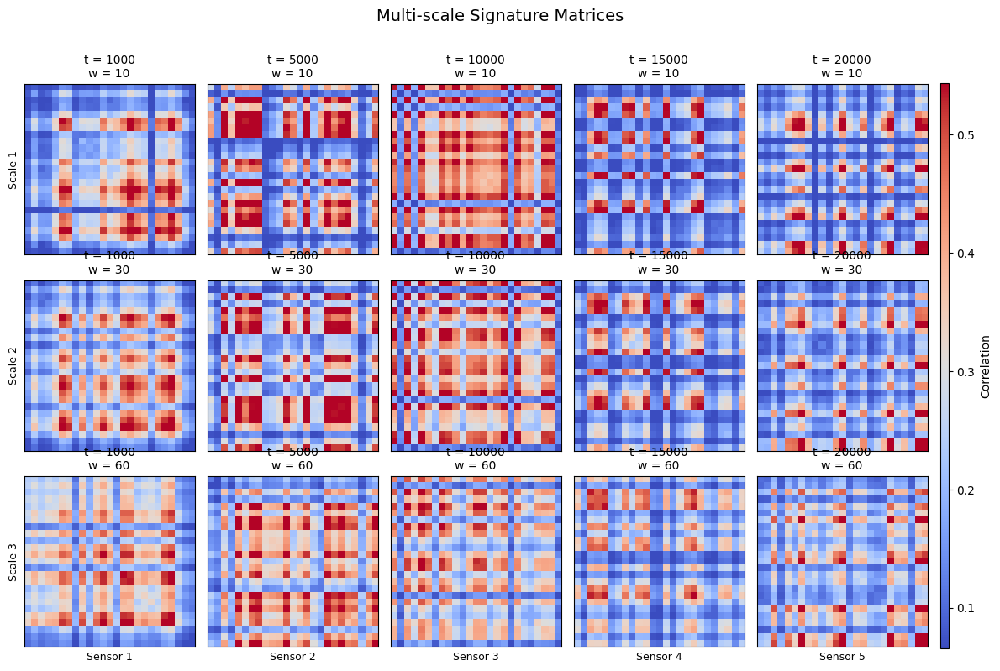

In [35]:
sample_times = [1000, 5000, 10000, 15000, 20000]

plot_signature_matrices(
    matrix_4d=signature_matrices,
    win_sizes=win_size,
    gap_time=gap_time,
    sample_times=sample_times,
    figsize=(12, 8)
)

In [ ]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
# imageio to register it
# import imageio

def create_signature_matrix_animation(
    matrix_4d: np.ndarray,
    window_index: int,
    win_size: int,
    gap_time: int = 10,
    output_path: str = "signature_animation.gif",
    fps: int = 10,
    figsize: tuple = (8, 6),
    dpi: int = 100
) -> HTML:
    """
    Creates an animation of signature matrices over time for a specific window.
    
    Args:
        matrix_4d: 4D array of signature matrices with shape [time, len(win_sizes), n, n]
        window_index: Index of the window to animate
        win_size: Window size (for title)
        gap_time: Time step between segments
        output_path: Path to save the GIF
        fps: Frames per second for animation
        figsize: Figure dimensions
        dpi: Resolution for output
    """
    # Entries validation
    if matrix_4d.ndim != 4:
        raise ValueError("Input matrix must be 4D array [time, len(win_sizes), n, n]")
    if window_index not in [i for i in range(matrix_4d.shape[1])]:
        raise ValueError("window_index must be in window range [0, 1, ..., n-1]")
    
    # Extract matrices and setup figure
    window_matrices = matrix_4d[:, window_index, :, :]
    n_frames = window_matrices.shape[0]
    
    # Create figure with constrained layout
    fig, ax = plt.subplots(figsize=figsize, dpi=dpi, constrained_layout=True)
    
    # Global color scale
    vmin, vmax = np.percentile(window_matrices, [5, 95])
    norm = plt.Normalize(vmin=vmin, vmax=vmax)
    
    # Create initial plot and colorbar
    im = ax.imshow(window_matrices[0], cmap='coolwarm', norm=norm)
    ax.set_title(f"Signature Matrix (Window size: {win_size})\nTime: 0")
    ax.set_xticks([])
    ax.set_yticks([])
    
    # Add single colorbar (outside the axes)
    cbar = fig.colorbar(im, ax=ax, shrink=0.8)
    cbar.set_label("Correlation")

    def update(frame):
        """Update function for animation"""
        im.set_array(window_matrices[frame])
        ax.set_title(f"Signature Matrix (Window size: {win_size})\nTime: {frame * gap_time}")
        return [im]

    # Create animation
    anim = FuncAnimation(
        fig,
        update,
        frames=min(n_frames, 200),  # Limit to 100 frames max for performance
        interval=1000/fps,  # ms between frames
        blit=True
    )
    
    # Register the animation with imageio
    # anim.save(output_path, writer='pillow', fps=fps)
    # plt.close(fig)
    # print(f"Animation saved to {output_path}")
    
    # Plot the animation in Jupyter Notebook
    plt.close(fig)  # Prevent double display
    return HTML(anim.to_jshtml())

In [40]:
create_signature_matrix_animation(
    matrix_4d=signature_matrices,
    window_index=0,
    win_size=10,
    gap_time=10,
    output_path="signature_animation_window10.gif",
    fps=5,
    figsize=(8, 6),
    dpi=100
)

In [41]:
create_signature_matrix_animation(
    matrix_4d=signature_matrices,
    window_index=1,
    win_size=30,
    gap_time=10,
    output_path="signature_animation_window30.gif",
    fps=5,
    figsize=(8, 6),
    dpi=100
)

In [42]:
create_signature_matrix_animation(
    matrix_4d=signature_matrices,
    window_index=2,
    win_size=60,
    gap_time=10,
    output_path="signature_animation_window60.gif",
    fps=5,
    figsize=(8, 6),
    dpi=100
)

### 3. Modèle MSCRED

1. Conv_LSTM unité
2. attention blocs
3. Encoder-Decoder
4. Loss adaptée
5. MSCRED total

In [ ]:
import torch
import torch.nn as nn

import os, sys

In [55]:
print("Torch version? ", torch.__version__)
print("Cuda?          ", torch.cuda.is_available())
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Device =", device)

Torch version?  2.4.1+cpu
Cuda?           False
Device = cpu


In [ ]:
## Convolutional Long-Short Term Memory (ConvLSTM) Cell
class ConvLSTMCell(nn.Module):
    """
    Convolutional LSTM cell for processing spatio-temporal data.
    
    Functions:
        __init__: Initializes the ConvLSTM cell with input channels, hidden channels, and kernel size.
        forward: Performs the forward pass of the ConvLSTM cell.
        init_hidden: Initializes the hidden and cell states for the ConvLSTM cell.

    Attributes:
        input_channels: Number of input channels.
        hidden_channels: Number of hidden channels.
        kernel_size: Size of the convolutional kernel.
        num_features: Number of features in the ConvLSTM cell (4 for input, forget, cell, output gates).
        padding: Padding size for the convolutional layers.
        Wxi, Whi, Wxf, Whf, Wxc, Whc, Wxo, Who: Convolutional layers for input, forget, cell, and output gates.
        Wci, Wcf, Wco: Cell state weights for input, forget, and output gates (initialized to None).
    """
    def __init__(
            self, 
            input_channels: int, 
            hidden_channels: int, 
            kernel_size: int | tuple
            ) -> None:
        super().__init__()

        assert hidden_channels % 2 == 0

        self.input_channels = input_channels
        self.hidden_channels = hidden_channels
        self.kernel_size = kernel_size
        self.num_features = 4

        self.padding = int((kernel_size - 1) / 2)

        self.Wxi = nn.Conv2d(in_channels=self.input_channels,  out_channels=self.hidden_channels, kernel_size=self.kernel_size, stride=1, padding=self.padding, bias=True )
        self.Whi = nn.Conv2d(in_channels=self.hidden_channels, out_channels=self.hidden_channels, kernel_size=self.kernel_size, stride=1, padding=self.padding, bias=False)
        self.Wxf = nn.Conv2d(in_channels=self.input_channels,  out_channels=self.hidden_channels, kernel_size=self.kernel_size, stride=1, padding=self.padding, bias=True )
        self.Whf = nn.Conv2d(in_channels=self.hidden_channels, out_channels=self.hidden_channels, kernel_size=self.kernel_size, stride=1, padding=self.padding, bias=False)
        self.Wxc = nn.Conv2d(in_channels=self.input_channels,  out_channels=self.hidden_channels, kernel_size=self.kernel_size, stride=1, padding=self.padding, bias=True )
        self.Whc = nn.Conv2d(in_channels=self.hidden_channels, out_channels=self.hidden_channels, kernel_size=self.kernel_size, stride=1, padding=self.padding, bias=False)
        self.Wxo = nn.Conv2d(in_channels=self.input_channels,  out_channels=self.hidden_channels, kernel_size=self.kernel_size, stride=1, padding=self.padding, bias=True)
        self.Who = nn.Conv2d(in_channels=self.hidden_channels, out_channels=self.hidden_channels, kernel_size=self.kernel_size, stride=1, padding=self.padding, bias=False)

        self.Wci = None
        self.Wcf = None
        self.Wco = None

    def forward(
            self, 
            x: torch.Tensor, 
            h: torch.Tensor, 
            c: torch.Tensor
            ) -> tuple[torch.Tensor]:
        """
        Forward pass of the ConvLSTM cell.

        Args:
            x: Input tensor of shape (batch_size, input_channels, height, width)
            h: Hidden state tensor of shape (batch_size, hidden_channels, height, width)
            c: Cell state tensor of shape (batch_size, hidden_channels, height, width)

        Returns:
            Tuple of updated hidden state and cell state tensors, shape (batch_size, hidden_channels, height, width)
        """
        ci = torch.sigmoid(self.Wxi(x) + self.Whi(h) + c * self.Wci)
        cf = torch.sigmoid(self.Wxf(x) + self.Whf(h) + c * self.Wcf)
        cc = cf * c + ci * torch.tanh(self.Wxc(x) + self.Whc(h))
        co = torch.sigmoid(self.Wxo(x) + self.Who(h) + cc * self.Wco)
        ch = co * torch.tanh(cc)
        return ch, cc

    def init_hidden(
            self,
            batch_size: int, 
            hidden: int, 
            shape: tuple[int, int], 
            device: str
            ) -> tuple[torch.Tensor]:
        """
        Initializes weight for the convLSTM cell. In two parts:
            - The weight matrices for the Input, Forget, and Output gates (Wci, Wcf, Wco). 
              These are initialized to zero tensors, in order to limit the influence of the cell state (and its gradient) in first iterations.
            
            - The very first hidden state and cell state (h and c). h and c represent respectively the short and long-term memory.
              Those are also initialized to zero tensors, because no history is available at the first time step.
        
        This is done only once, at the first step of the forward pass.

        Args:
            batch_size: Size of the batch
            hidden: Number of hidden channels
            shape: Shape of the input (height, width)
            device: Device to place the tensors on

        Returns:
            Tuple of initialized hidden state and cell state tensors.
        """
        if self.Wci is None:
            self.Wci = torch.zeros(1, hidden, shape[0], shape[1], device=device)
            self.Wcf = torch.zeros(1, hidden, shape[0], shape[1], device=device)
            self.Wco = torch.zeros(1, hidden, shape[0], shape[1], device=device)
        else:
            assert shape[0] == self.Wci.shape[2], 'Input Height Mismatched!'
            assert shape[1] == self.Wci.shape[3], 'Input Width Mismatched!'
        return (torch.zeros(batch_size, hidden, shape[0], shape[1], device=device),
                torch.zeros(batch_size, hidden, shape[0], shape[1], device=device))


class ConvLSTM(nn.Module):
    # input_channels corresponds to the first input feature map
    # hidden state is a list of succeeding lstm layers.
    """
    Convolutional LSTM model for processing spatio-temporal data.

    Functions:
        __init__: Initializes the ConvLSTM model with input channels, hidden channels, kernel size, step, and effective step.
        forward: Performs the forward pass of the ConvLSTM model.

    Attributes:
        input_channels: List of input channels for each layer.
        hidden_channels: List of hidden channels for each layer.
        kernel_size: Size of the convolutional kernel.
        num_layers: Number of ConvLSTM layers.
        step: Number of steps to process in the forward pass.
        effective_step: List of effective steps to record outputs.
        _all_layers: List of all ConvLSTM cells in the model.   
    """
    def __init__(
            self, 
            input_channels: int, 
            hidden_channels: list[int], 
            kernel_size: int | tuple, 
            step: int = 1, 
            effective_step: int = [1]
            ) -> None:
        super().__init__()
        self.input_channels = [input_channels] + hidden_channels
        self.hidden_channels = hidden_channels
        self.kernel_size = kernel_size
        self.num_layers = len(hidden_channels)
        self.step = step
        self.effective_step = effective_step
        self._all_layers = []
        for i in range(self.num_layers):
            name = 'cell{}'.format(i)
            cell = ConvLSTMCell(self.input_channels[i], self.hidden_channels[i], self.kernel_size)
            setattr(self, name, cell)
            self._all_layers.append(cell)

    def forward(
            self, 
            input: torch.Tensor
            ) -> tuple[list[torch.Tensor], tuple[torch.Tensor]]:
        """
        Forward pass of the ConvLSTM model.
        A ConvLSTM model is a sequence of ConvLSTM cells that processes the input tensor over multiple steps.

        Args:
            input: Input tensor of shape (self.step, batch_size, input_channels, height, width)

        Returns:
            Tuple containing:
                - List of output tensors for each effective step
                - Tuple of the last hidden state and cell state tensors
        """
        internal_state = []
        outputs = []
        for step_idx in range(self.step):
            x = input[step_idx]
            for i in range(self.num_layers):
                # all cells are initialized in the first step
                name = 'cell{}'.format(i)
                if step_idx == 0:
                    bsize, _, height, width = x.shape
                    (h, c) = getattr(self, name).init_hidden(batch_size=bsize, hidden=self.hidden_channels[i],
                                                             shape=(height, width), device=x.device)
                    internal_state.append((h, c))

                # do forward
                (h, c) = internal_state[i]
                x, new_c = getattr(self, name)(x, h, c)
                internal_state[i] = (x, new_c)
            # only record effective steps
            if step_idx in self.effective_step:
                outputs.append(x)

        return outputs, (x, new_c)


#### Test ConvLSTMCell

In [63]:
batch_size = 10
input_channels = 3
hidden_channels = 64
height, width = 32, 32
kernel_size = 3
x = torch.randn(batch_size, input_channels, height, width).to(device)

convlstm_cell = ConvLSTMCell(
    input_channels=input_channels,
    hidden_channels=hidden_channels,
    kernel_size=kernel_size
).to(device)
h, c = convlstm_cell.init_hidden(batch_size, hidden_channels, (height, width), device)
new_h, new_c = convlstm_cell(x, h, c)

print("Shape of input x:", x.shape)
print("\nShape of first hidden state h:    ", h.shape)
print("Shape of first cell   state c:    ", c.shape)
print("Shape of new   hidden state new_h:", new_h.shape)
print("Shape of new   cell   state new_c:", new_c. shape)
assert new_h.shape == (batch_size, hidden_channels, height, width)
assert new_c.shape == new_h.shape
print("\nAll shapes are correct!")

Shape of input x: torch.Size([10, 3, 32, 32])

Shape of first hidden state h:     torch.Size([10, 64, 32, 32])
Shape of first cell   state c:     torch.Size([10, 64, 32, 32])
Shape of new   hidden state new_h: torch.Size([10, 64, 32, 32])
Shape of new   cell   state new_c: torch.Size([10, 64, 32, 32])

All shapes are correct!


#### Test ConvLSTM

In [65]:
batch_size = 10
input_channels = 3
hidden_channels = [32, 64, 128]
height, width = 32, 32
kernel_size = 3
steps = 5
effective_step = [0, 2, 4]

x = torch.randn(batch_size, input_channels, height, width).to(device)

convlstm = ConvLSTM(
    input_channels=input_channels,
    hidden_channels=hidden_channels,
    kernel_size=kernel_size,
    step=steps,
    effective_step=effective_step
).to(device)
outputs, (final_h, final_c) = convlstm(x)


print("Shape of input x:", x.shape)
print("Number of ConvLSTM layers:", len(convlstm.hidden_channels))
print("Number of ConvLSTM layers 2:", convlstm.num_layers)
print("Number of recorded outputs:", len(outputs))
print("Effective steps:", convlstm.effective_step)
print("Layer type:", type(convlstm._all_layers[0]))

print("\nShape of output tensors:")
for i, step in enumerate(convlstm.effective_step):
    print(f"Output of step {step}:")
    print("Shape:", outputs[i].shape)
assert outputs[i].shape == (batch_size, hidden_channels[-1], height, width)

print("\nShape of last hidden state final_h:", final_h.shape)
print("Shape of last cell state final_c:", final_c.shape)
assert final_h.shape == (batch_size, hidden_channels[-1], height, width)
assert final_c.shape == (batch_size, hidden_channels[-1], height, width)

print("\nAll shapes are correct!")

Shape of input x: torch.Size([10, 3, 32, 32])
Number of ConvLSTM layers: 3
Number of ConvLSTM layers 2: 3
Number of recorded outputs: 3
Effective steps: [0, 2, 4]
Layer type: <class '__main__.ConvLSTMCell'>

Shape of output tensors:
Output of step 0:
Shape: torch.Size([10, 128, 32, 32])
Output of step 2:
Shape: torch.Size([10, 128, 32, 32])
Output of step 4:
Shape: torch.Size([10, 128, 32, 32])

Shape of last hidden state final_h: torch.Size([10, 128, 32, 32])
Shape of last cell state final_c: torch.Size([10, 128, 32, 32])

All shapes are correct!


In [79]:
## Attention mechanism for ConvLSTM output
def attention(
        ConvLstm_out: torch.Tensor,
        rescale_factor: float = 5.0
        ) -> torch.Tensor:
    """
    Attention mechanism for ConvLSTM output.

    Args:
        ConvLstm_out: Tensor output from the ConvLSTM layer. Shape (n_timestep, batch_size, channels, height, width)
        n: Number of steps to consider for attention weighting.

    Returns:
        Tensor: The output after applying the attention mechanism.

    Nota bene:
        The rescale_factor is used to normalize the similarity scores between the dot product of the 
        hidden states and the softmax function.
        The value of 5 is empirically determined.
        This value is a compromise between producing uniform attention weights (large rescale_factor) 
        and producing a sharp distribution in weights (small rescale_factor) with the softmax function.
    """
    assert rescale_factor > 0, "Rescale factor must be positive"
    n_timestep = ConvLstm_out.shape[0]
    batch_size, channels, height, width = ConvLstm_out.shape[1:]

    attention_w = []
    for k in range(n_timestep):
        similarity = torch.sum(torch.mul(ConvLstm_out[k], ConvLstm_out[-1]))/rescale_factor
        attention_w.append(similarity)
    attention_w = torch.softmax(torch.stack(attention_w), dim=0)

    # Broadcasting
    attention_w = attention_w.view(n_timestep, 1, 1, 1, 1)      # Facultative but recommended for clarity
    weighted = attention_w * ConvLstm_out
    convLstmOut = torch.sum(weighted, dim=0)
    
    return convLstmOut

#### Test attention function

In [80]:
n_timestep = 5
batch_size = 10
channels = 3
height = 25
width = 25

conv_lstm_out = torch.randn(n_timestep, batch_size, channels, height, width)

attention_output = attention(conv_lstm_out)

print("Attention output shape:", attention_output.shape)
assert attention_output.shape == (batch_size, channels, height, width), \
f"Expected shape: {(batch_size, channels, height, width)}, obtained: {attention_output.shape}"
assert not torch.isnan(attention_output).any(), "Result contains NaN values"
assert not torch.isinf(attention_output).any(), "Result contains infinite values"

for rescale in [0.1, 1.0, 5.0, 10.0, 100.0]:
    try:
        output = attention(conv_lstm_out, rescale_factor=rescale)
        assert output.shape == (batch_size, channels, height, width)
    except Exception as e:
        assert False, f"Error with rescale_factor={rescale}: {str(e)}"

print("\nAll tests passed with success!")

Attention output shape: torch.Size([10, 3, 25, 25])

All tests passed with success!


In [93]:
## Encoder-Decoder modules
class CnnEncoder(nn.Module):
    """
    CNN Encoder module

    This module applies a series of convolutional layers to the input data.
    Shapes: (batch_size, 32,  height,    width)    after conv1 (stride 1)
            (batch_size, 64,  height//2, width//2) after conv2 (stride 2)
            (batch_size, 128, height//4, width//4) after conv3 (stride 2)
            (batch_size, 256, height//8, width//8) after conv4 (stride 2)
    """
    def __init__(self, in_channels_encoder: int = 3) -> None:
        """
        We have chosen SELU() activation function for its self-normalizing properties.

        Advices:
            - in_channels = [input_size, 32, 64, 128]
            - out_channels = [32, 64, 128, 256]
            - kernel_sizes = [3, 3, 2, 2]
            - stride must be (2, 2) for the first three layers, (1, 1) for the last layer (no dimension reduction)
            - padding must be (0, 0) for the last layer (no operations after the last layer), (1, 1) for the others
        """
        super().__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels=in_channels_encoder, out_channels=32, kernel_size=3, stride=(1, 1), padding=1),
            nn.SELU()
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, stride=(2, 2), padding=1),
            nn.SELU()
        )    
        self.conv3 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=2, stride=(2, 2), padding=0),
            nn.SELU()
        )   
        # self.conv4 = nn.Sequential(
        #     nn.Conv2d(in_channels=128, out_channels=256, kernel_size=2, stride=(2, 2), padding=0),
        #     nn.SELU()
        # )
    def forward(self, X: torch.Tensor) -> tuple[torch.Tensor]:
        """
        Forward pass for the CNN encoder

        Args:
            X (torch.Tensor): Input tensor

        Returns:
            Tuple[torch.Tensor]: Output tensors from each convolutional layer
        """
        conv1_out = self.conv1(X)
        conv2_out = self.conv2(conv1_out)
        conv3_out = self.conv3(conv2_out)
        # conv4_out = self.conv4(conv3_out)
        return conv1_out, conv2_out, conv3_out#, conv4_out


class Conv_LSTM(nn.Module):
    """
    Convolutional LSTM module

    This module applies a series of ConvLSTM layers to the input data.
    """
    def __init__(self) -> None:
        super().__init__()
        self.conv1_lstm = ConvLSTM(input_channels=32, hidden_channels=[32], 
                                   kernel_size=3, step=5, effective_step=[1, 3, 4])
        self.conv2_lstm = ConvLSTM(input_channels=64, hidden_channels=[64], 
                                   kernel_size=3, step=5, effective_step=[1, 3, 4])
        self.conv3_lstm = ConvLSTM(input_channels=128, hidden_channels=[128], 
                                   kernel_size=3, step=5, effective_step=[1, 3, 4])
        # self.conv4_lstm = ConvLSTM(input_channels=256, hidden_channels=[256], 
        #                            kernel_size=3, step=5, effective_step=[4])

    def forward(self, conv1_out: torch.Tensor, conv2_out: torch.Tensor, conv3_out: torch.Tensor, conv4_out: torch.Tensor = 0) -> tuple[torch.Tensor]:
        """
        ConvLSTM forward pass
        convi_lstm_out is a tuple (outputs, (x, new_c))
            output is the registered hidden state of effective_step list
            (x, new_c) is the hidden state and cell state for the last step
        Exemple of shape for conv2_lstm_out:
            output.shape = (batch_size, 64, height/2, width/2)
            x.shape = new_c.shape = (batch_size, 64, height/2, width/2)
        So convi_lstm_out[0][0] is the first element of output.

        Args:
            convi_out (torch.Tensor): Output from the ith convolutional layer
            conv4_out (torch.Tensor, optional): Output from the fourth convolutional layer

        Returns:
            Tuple[torch.Tensor]: Output tensors from each ConvLSTM layer
        """
        # resize to be shape [5, B, C, H, W]
        conv1_lstm_out = self.conv1_lstm(conv1_out)
        conv1_lstm_out = attention(ConvLstm_out=torch.stack(conv1_lstm_out[0], dim=0))
        conv2_lstm_out = self.conv2_lstm(conv2_out)
        conv2_lstm_out = attention(ConvLstm_out=torch.stack(conv2_lstm_out[0], dim=0))
        conv3_lstm_out = self.conv3_lstm(conv3_out)
        conv3_lstm_out = attention(ConvLstm_out=torch.stack(conv3_lstm_out[0], dim=0))
        # conv4_lstm_out = self.conv4_lstm(conv4_out)
        # conv4_lstm_out = attention(ConvLstm_out=torch.stack(conv4_lstm_out[0], dim=0))
        return conv1_lstm_out.unsqueeze(0), conv2_lstm_out.unsqueeze(0), conv3_lstm_out.unsqueeze(0), #conv4_lstm_out.unsqueeze(0)

class CnnDecoder(nn.Module):
    """
    CNN Decoder module

    This module applies a series of transposed convolutional layers to the input data.
    Shapes: (batch_size, 128, height*2, width*2) after deconv4 (stride 2)
            (batch_size, 256, height*2, width*2) after first concatenation
            (batch_size, 64,  height*4, width*4) after deconv3 (stride 2)
            (batch_size, 128, height*4, width*4) after second concatenation
            (batch_size, 32,  height*8, width*8) after deconv2 (stride 2)
            (batch_size, 64,  height*8, width*8) after first concatenation
            (batch_size, 3,   height*8, width*8) after deconv1 (stride 1)
    """
    def __init__(self, encoder_in_channels: int = 3) -> None:
        """
        We have chosen SELU() activation function for its self-normalizing properties.
        
        Advices:
            - in_channels = hidden_channels of the corresponding ConvLSTM layer + concatenation
                + if conv4_lstm_out is not None, [256, 256, 128, 64]
                + if conv4_lstm_out is None, [128, 128, 64]
            - out_channels
                + if conv4_lstm_out is not None, [128, 64, 32, encoder_in_channels]
                + if conv4_lstm_out is None, [64, 32, encoder_in_channels]
            - kernel_sizes = [2, 2, 3, 3]
            - stride must be (2, 2) for the first three layers, (1, 1) for the last layer (no dimension reduction)
            - padding must be (0, 0) for the first layer, (1, 1) for the others
            - output_padding must be (0, 0) for the first and last layer, (1, 1) for the others

        """
        super().__init__()
        # self.deconv4 = nn.Sequential(
        #     nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=2, stride=2, padding=0, output_padding=0),
        #     nn.SELU()
        # )
        ### If conv4_lstm_out is not None, put in_channels(self.deconv3)=256, else 128
        self.deconv3 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=2, stride=2, padding=0, output_padding=0),
            nn.SELU()
        )
        self.deconv2 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=128, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.SELU()
        )
        self.deconv1 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=64, out_channels=encoder_in_channels, kernel_size=3, stride=1, padding=1, output_padding=0),
            nn.SELU()
        )

    def forward(self, conv1_lstm_out: torch.Tensor, conv2_lstm_out: torch.Tensor, conv3_lstm_out: torch.Tensor, conv4_lstm_out: torch.Tensor = 0) -> torch.Tensor:
        """
        Forward pass for the CNN decoder

        Args:
            conv1_lstm_out (torch.Tensor): Output from the first LSTM layer
            conv2_lstm_out (torch.Tensor): Output from the second LSTM layer
            conv3_lstm_out (torch.Tensor): Output from the third LSTM layer
            conv4_lstm_out (torch.Tensor, optional): Output from the fourth LSTM layer

        Returns:
            torch.Tensor: Output tensor from the decoder
        """
        # deconv4 = self.deconv4(conv4_lstm_out)
        # deconv4_concat = torch.cat((deconv4, conv3_lstm_out), dim = 1)
        deconv3 = self.deconv3(conv3_lstm_out)#deconv3 = self.deconv3(deconv4_concat)
        deconv3_concat = torch.cat((deconv3, conv2_lstm_out), dim = 1)
        deconv2 = self.deconv2(deconv3_concat)
        deconv2_concat = torch.cat((deconv2, conv1_lstm_out), dim = 1)
        deconv1 = self.deconv1(deconv2_concat)
        return deconv1
    

#### Test for CNN Encoder

In [91]:
batch_size = 10
height = 32
width = 32
in_channels = 3

X = torch.randn(batch_size, in_channels, height, width)

encoder = CnnEncoder(in_channels_encoder=in_channels)
conv1_out, conv2_out, conv3_out = encoder(X)

print("Shape of input X:", X.shape)

print("\nConv1_out shape (must be the same because stride 1):", conv1_out.shape)
assert conv1_out.shape == (batch_size, 32, height, width), f"conv1_out shape expected: {(batch_size, 32, height, width)}, obtained: {conv1_out.shape}"

print("Conv2_out shape (should be half the height and width due to stride 2):", conv2_out.shape)
assert conv2_out.shape == (batch_size, 64, height//2, width//2), f"conv2_out shape expected: {(batch_size, 64, height//2, width//2)}, obtained: {conv2_out.shape}"

print("Conv3_out shape (should be a quarter of the height and width due to stride 2):", conv3_out.shape)
assert conv3_out.shape == (batch_size, 128, height//4, width//4), f"conv3_out shape expected: {(batch_size, 128, height//4, width//4)}, obtained: {conv3_out.shape}"


for name, tensor in [('conv1_out', conv1_out), ('conv2_out', conv2_out), ('conv3_out', conv3_out)]: 
    assert not torch.isnan(tensor).any(), f"{name} contains NaN" 
    assert not torch.isinf(tensor).any(), f"{name} contains infinite values"

test_sizes = [(32, 32), (64, 64), (128, 128)]
for h, w in test_sizes: 
    try: 
        X_test = torch.randn(batch_size, in_channels, h, w) 
        c1, c2, c3 = encoder(X_test) 
        assert c1.shape == (batch_size, 32, h, w) 
        assert c2.shape == (batch_size, 64, h//2, w//2) 
        assert c3.shape == (batch_size, 128, h//4, w//4)
    except Exception as e:
        assert False, f"Error with input size {(h,w)}: {str(e)}"

print("\nAll CNN Encoder tests passed!")

Shape of input X: torch.Size([10, 3, 32, 32])

Conv1_out shape (must be the same because stride 1): torch.Size([10, 32, 32, 32])
Conv2_out shape (should be half the height and width due to stride 2): torch.Size([10, 64, 16, 16])
Conv3_out shape (should be a quarter of the height and width due to stride 2): torch.Size([10, 128, 8, 8])

All CNN Encoder tests passed!


#### Test for CNN Decoder

We test the 3 stage Decoder

In [95]:
batch_size = 10
base_height = 4
base_width = 4
encoder_in_channels = 3

# Simulated outputs from ConvLSTM layers
conv1_lstm_out = torch.randn(batch_size, 32, base_height*8, base_width*8)
conv2_lstm_out = torch.randn(batch_size, 64, base_height*4, base_width*4)
conv3_lstm_out = torch.randn(batch_size, 128, base_height*2, base_width*2)

decoder = CnnDecoder(encoder_in_channels=encoder_in_channels)
output = decoder(conv1_lstm_out, conv2_lstm_out, conv3_lstm_out)

expected_shape = (batch_size, encoder_in_channels, base_height*8, base_width*8)
assert output.shape == expected_shape, f"Expected shape: {expected_shape}, obtained: {output.shape}"
assert not torch.isnan(output).any(), "Result contains NaNs"
assert not torch.isinf(output).any(), "Result contains infinite values"

print("\nTest with different input sizes:")
test_sizes = [(4, 4), (8, 8), (16, 16)]
for h, w in test_sizes:
    try:
        conv1 = torch.randn(batch_size, 32, h*8, w*8)
        conv2 = torch.randn(batch_size, 64, h*4, w*4)
        conv3 = torch.randn(batch_size, 128, h*2, w*2)

        out = decoder(conv1, conv2, conv3)
        assert out.shape == (batch_size, 3, h*8, w*8), f"Failed for base size {(h,w)}: got {out.shape}"
        print(f"Passed for base size {(h,w)}: got {out.shape}")
        
    except Exception as e:
        assert False, f"Error with base size {(h,w)}: {str(e)}"

print("\nAll CNN Decoder tests passed!")


Test with different input sizes:
Passed for base size (4, 4): got torch.Size([10, 3, 32, 32])
Passed for base size (8, 8): got torch.Size([10, 3, 64, 64])
Passed for base size (16, 16): got torch.Size([10, 3, 128, 128])

All CNN Decoder tests passed!


#### Test for ConvLSTM Total

In [96]:
batch_size = 10
height = 32
width = 32
timesteps = 5

# Simulated outputs from Encoder
conv1_out = torch.randn(timesteps, batch_size, 32, height, width)        # Conv1
conv2_out = torch.randn(timesteps, batch_size, 64, height//2, width//2)  # Conv2
conv3_out = torch.randn(timesteps, batch_size, 128, height//4, width//4) # Conv3

conv_lstm = Conv_LSTM()

# Test 1: Sans conv4_out
print("Test sans conv4_out:")
conv1_lstm, conv2_lstm, conv3_lstm = conv_lstm(conv1_out, conv2_out, conv3_out)

# Vérification des shapes de sortie
assert conv1_lstm.shape == (1, batch_size, 32, height, width), \
    f"conv1_lstm shape attendu: {(1, batch_size, 32, height, width)}, obtenu: {conv1_lstm.shape}"

assert conv2_lstm.shape == (1, batch_size, 64, height//2, width//2), \
    f"conv2_lstm shape attendu: {(1, batch_size, 64, height//2, width//2)}, obtenu: {conv2_lstm.shape}"

assert conv3_lstm.shape == (1, batch_size, 128, height//4, width//4), \
    f"conv3_lstm shape attendu: {(1, batch_size, 128, height//4, width//4)}, obtenu: {conv3_lstm.shape}"

# Test 2: Avec conv4_out (décommentez les parties correspondantes dans le code pour ce test)
# print("\nTest avec conv4_out:")
# conv1_lstm, conv2_lstm, conv3_lstm, conv4_lstm = conv_lstm(conv1_out, conv2_out, conv3_out, conv4_out)
# assert conv4_lstm.shape == (1, batch_size, 256, height//8, width//8)

# Vérification des valeurs
for name, tensor in [('conv1_lstm', conv1_lstm),
                        ('conv2_lstm', conv2_lstm),
                        ('conv3_lstm', conv3_lstm)]:
    assert not torch.isnan(tensor).any(), f"{name} contient des NaN"
    assert not torch.isinf(tensor).any(), f"{name} contient des valeurs infinies"
    assert tensor.requires_grad, f"{name} ne conserve pas le gradient"

# Test avec différentes tailles
print("\nTest avec différentes tailles d'entrée:")
test_sizes = [(32, 32), (64, 64), (128, 128)]
for h, w in test_sizes:
    try:
        # Recréer les entrées avec les nouvelles dimensions
        conv1 = torch.randn(timesteps, batch_size, 32, h, w)
        conv2 = torch.randn(timesteps, batch_size, 64, h//2, w//2)
        conv3 = torch.randn(timesteps, batch_size, 128, h//4, w//4)
        
        # Tester le ConvLSTM
        out1, out2, out3 = conv_lstm(conv1, conv2, conv3)
        
        # Vérifications
        assert out1.shape == (1, batch_size, 32, h, w)
        assert out2.shape == (1, batch_size, 64, h//2, w//2)
        assert out3.shape == (1, batch_size, 128, h//4, w//4)
        
    except Exception as e:
        assert False, f"Erreur avec taille {(h,w)}: {str(e)}"

print("Tous les tests du Conv_LSTM passés avec succès!")

Test sans conv4_out:


ValueError: too many values to unpack (expected 4)

In [ ]:
## Encoder-Decoder global model
class MSCRED(nn.Module):
    """
    Multi-Scale Convolutional Recurrent Encoder-Decoder

    This model combines CNN Autoencoder and ConvLSTM layers for spatiotemporal feature extraction.
    """
    def __init__(self, in_channels_encoder: int, in_channels_decoder: int) -> None:
        super().__init__()
        self.cnn_encoder = CnnEncoder(in_channels_encoder)
        self.conv_lstm = Conv_LSTM()
        self.cnn_decoder = CnnDecoder(in_channels_decoder)
    
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        """
        Forward pass for the MSCRED model

        Args:
            x (torch.Tensor): Input tensor. Shape (batch_size, channels, height, width)

        Returns:
            torch.Tensor: Reconstructed tensor from the decoder
        """
        conv1_out, conv2_out, conv3_out = self.cnn_encoder(x)
        conv1_lstm_out, conv2_lstm_out, conv3_lstm_out = self.conv_lstm(conv1_out, conv2_out, conv3_out)

        gen_x = self.cnn_decoder(conv1_lstm_out, conv2_lstm_out, conv3_lstm_out)
        return gen_x


In [ ]:
def generate_train_test_data():
	save_data_path = ".././data/mscred/"

	#data sample generation
	print ("generating train/test data samples...")
	matrix_data_path = save_data_path + "matrix_data/"

	train_data_path = matrix_data_path + "train_data/"
	if not os.path.exists(train_data_path):
		os.makedirs(train_data_path)
	test_data_path = matrix_data_path + "test_data/"
	if not os.path.exists(test_data_path):
		os.makedirs(test_data_path)

	data_all = []
	# for value_col in value_colnames:
	for w in range(len(win_size)):
		#path_temp = matrix_data_path + "matrix_win_" + str(win_size[w]) + str(value_col) + ".npy"
		path_temp = matrix_data_path + "matrix_win_" + str(win_size[w]) + ".npy"
		data_all.append(np.load(path_temp))

	train_test_time = [[train_start, train_end], [test_start, test_end]]
	for i in range(len(train_test_time)):
		for data_id in range(int(train_test_time[i][0]/gap_time), int(train_test_time[i][1]/gap_time)):
			#print data_id
			step_multi_matrix = []
			for step_id in range(step_max, 0, -1):
				multi_matrix = []
				# for k in range(len(value_colnames)):
				for i in range(len(win_size)):
					multi_matrix.append(data_all[i][data_id - step_id])
				step_multi_matrix.append(multi_matrix)

			if data_id >= (train_start/gap_time + win_size[-1]/gap_time + step_max) and data_id < (train_end/gap_time): # remove start points with invalid value
				path_temp = os.path.join(train_data_path, 'train_data_' + str(data_id))
				np.save(path_temp, step_multi_matrix)
			elif data_id >= (test_start/gap_time) and data_id < (test_end/gap_time):
				path_temp = os.path.join(test_data_path, 'test_data_' + str(data_id))
				np.save(path_temp, step_multi_matrix)

			#print np.shape(step_multi_matrix)

			del step_multi_matrix[:]

	print ("train/test data generation finish!")

In [ ]:
splits = ["train", "test"]
train_data_path = "./data/matrix_data/train_data/"
test_data_path = "./data/matrix_data/test_data/"
shuffle = {'train': True, 'test': False}

def load_data():
    dataset = {}
    train_file_list = os.listdir(train_data_path)
    test_file_list = os.listdir(test_data_path)
    train_file_list.sort(key = lambda x:int(x[11:-4]))
    test_file_list.sort(key = lambda x:int(x[10:-4]))
    train_data, test_data = [],[]
    for obj in train_file_list:   
        train_file_path = train_data_path + obj
        train_matrix = np.load(train_file_path)
        #train_matrix = np.transpose(train_matrix, (0, 2, 3, 1))
        train_data.append(train_matrix)

    for obj in test_file_list:
        test_file_path = test_data_path + obj
        test_matrix = np.load(test_file_path)
        #test_matrix = np.transpose(test_matrix, (0, 2, 3, 1))
        test_data.append(test_matrix)

    dataset["train"] = torch.from_numpy(np.array(train_data)).float()
    dataset["test"] = torch.from_numpy(np.array(test_data)).float()

    dataloader = {x: torch.utils.data.DataLoader(
                                dataset=dataset[x], batch_size=1, shuffle=shuffle[x]) 
                                for x in splits}
    return dataloader

In [ ]:
def train(dataLoader, model, optimizer, epochs, device):
    model = model.to(device)
    print("------training on {}-------".format(device))
    for epoch in range(epochs):
        train_l_sum,n = 0.0, 0
        for x in tqdm(dataLoader):
            x = x.to(device)
            x = x.squeeze()
            #print(type(x))
            l = torch.mean((model(x)-x[-1].unsqueeze(0))**2)
            train_l_sum += l
            optimizer.zero_grad()
            l.backward()
            optimizer.step()
            n += 1
            #print("[Epoch %d/%d][Batch %d/%d] [loss: %f]" % (epoch+1, epochs, n, len(dataLoader), l.item()))
            
        print("[Epoch %d/%d] [loss: %f]" % (epoch+1, epochs, train_l_sum/n))

def test(dataLoader, model):
    print("------Testing-------")
    index = 800
    loss_list = []
    reconstructed_data_path = "./data/matrix_data/reconstructed_data/"
    with torch.no_grad():
        for x in dataLoader:
            x = x.to(device)
            x = x.squeeze()
            reconstructed_matrix = model(x) 
            path_temp = os.path.join(reconstructed_data_path, 'reconstructed_data_' + str(index) + ".npy")
            np.save(path_temp, reconstructed_matrix.cpu().detach().numpy())
            # l = criterion(reconstructed_matrix, x[-1].unsqueeze(0)).mean()
            # loss_list.append(l)
            # print("[test_index %d] [loss: %f]" % (index, l.item()))
            index += 1
